<a href="https://colab.research.google.com/github/cdh-catt/MachineLearning/blob/main/BuildAndTrainModel/TransferLearning/TrainingModelHandGesture_TransferLearning_WithTest.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Data Preprocessing

In [1]:
import kagglehub # get dataset from kaggle

# Download latest version
# faster than mounting in Colab
path = kagglehub.dataset_download("agungmrf/indonesian-sign-language-bisindo")

print("Path to dataset files:", path)

100%|██████████| 1.36G/1.36G [00:17<00:00, 84.1MB/s]

Extracting files...


Path to dataset files: /root/.cache/kagglehub/datasets/agungmrf/indonesian-sign-language-bisindo/versions/1


In [2]:
import os
import shutil # for move files

# Define the destination path
destination_path = "/content"

# create directory, make sure path exist
os.makedirs(destination_path, exist_ok=True)

# Move the downloaded dataset to the destination
for item in os.listdir(path):
    source = os.path.join(path, item)
    shutil.move(source, destination_path)

print("Dataset moved to:", destination_path)


Dataset moved to: /content


#Data Exploration

Training Dataset:


Class: D - Sample Quantity: 348
-----------------------------------------------------


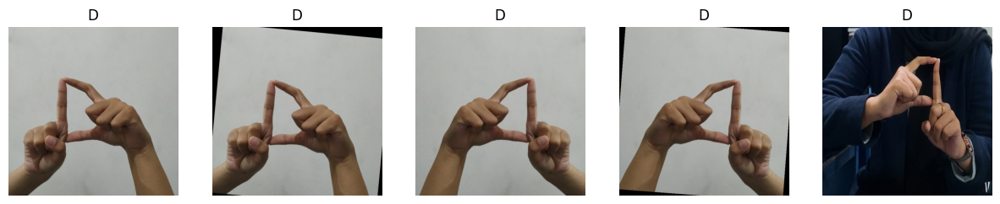

Class: W - Sample Quantity: 360
-----------------------------------------------------


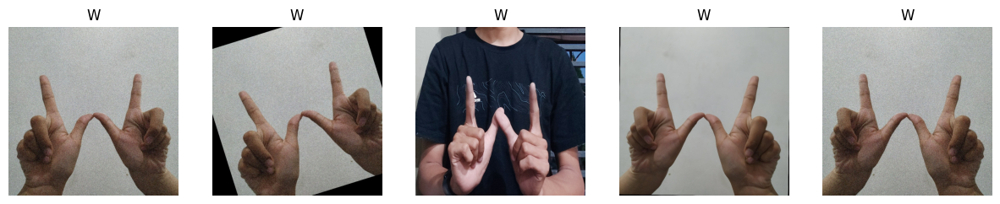

Class: R - Sample Quantity: 350
-----------------------------------------------------


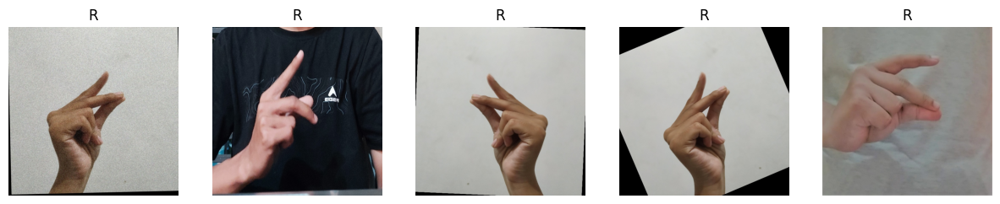

Class: K - Sample Quantity: 348
-----------------------------------------------------


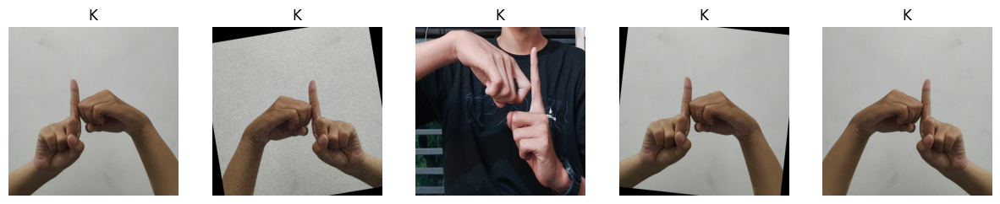

Class: J - Sample Quantity: 360
-----------------------------------------------------


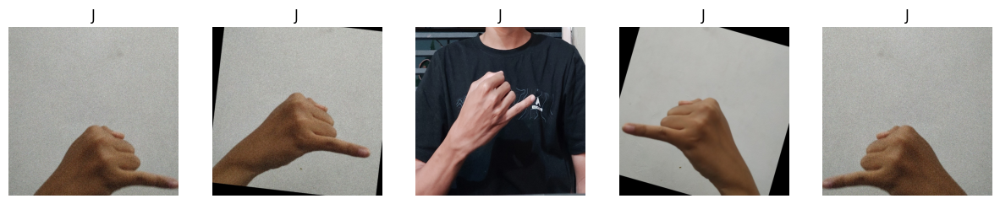

Class: E - Sample Quantity: 352
-----------------------------------------------------


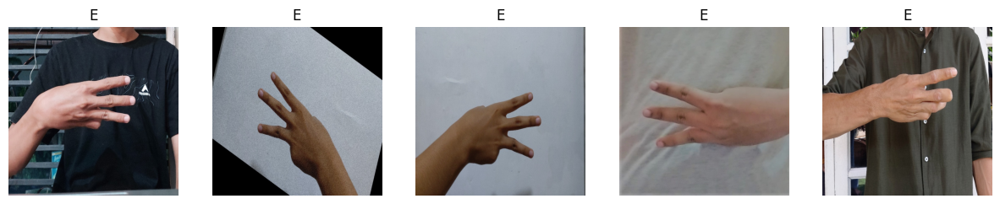

Class: O - Sample Quantity: 357
-----------------------------------------------------


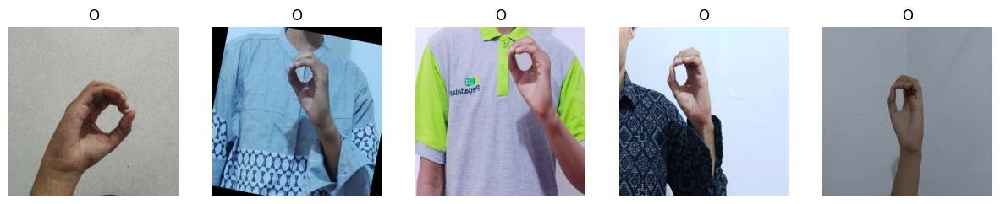

Class: I - Sample Quantity: 360
-----------------------------------------------------


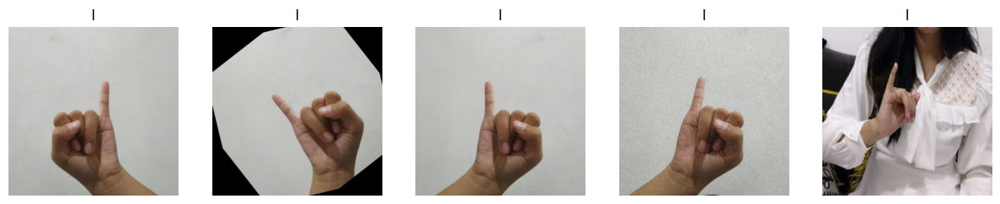

Class: Y - Sample Quantity: 328
-----------------------------------------------------


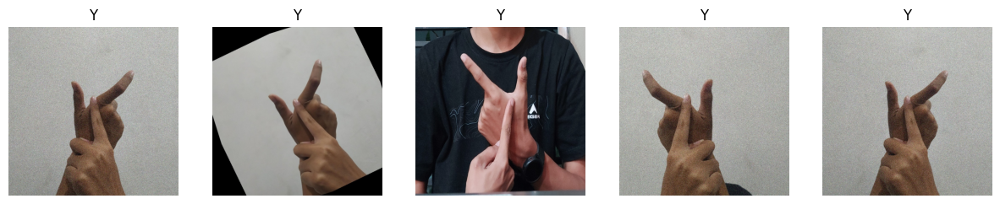

Class: H - Sample Quantity: 348
-----------------------------------------------------


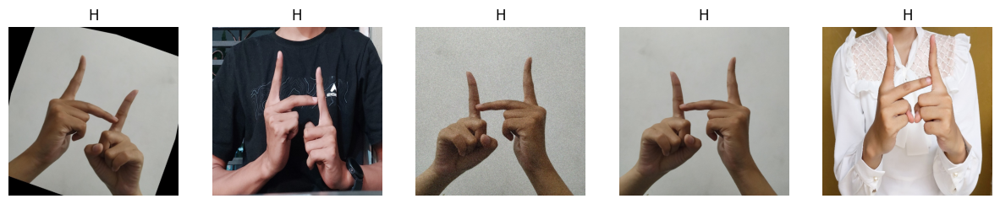

Class: P - Sample Quantity: 357
-----------------------------------------------------


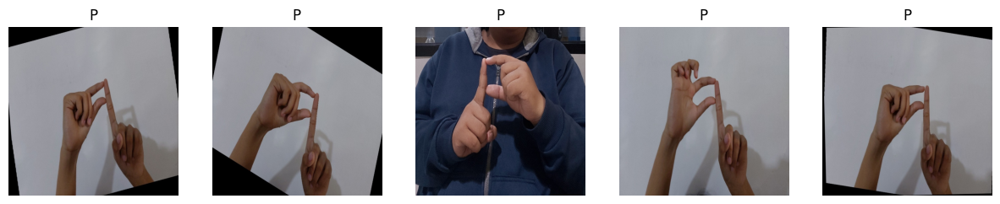

Class: Q - Sample Quantity: 348
-----------------------------------------------------


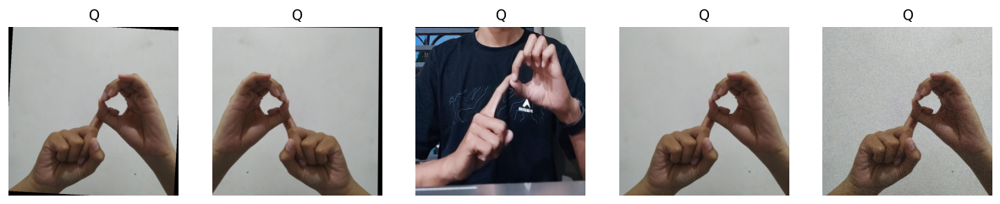

Class: T - Sample Quantity: 360
-----------------------------------------------------


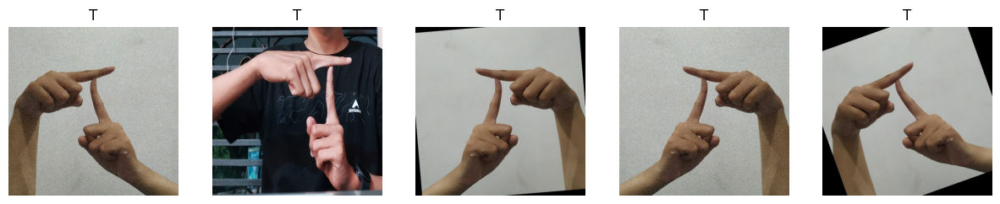

Class: L - Sample Quantity: 357
-----------------------------------------------------


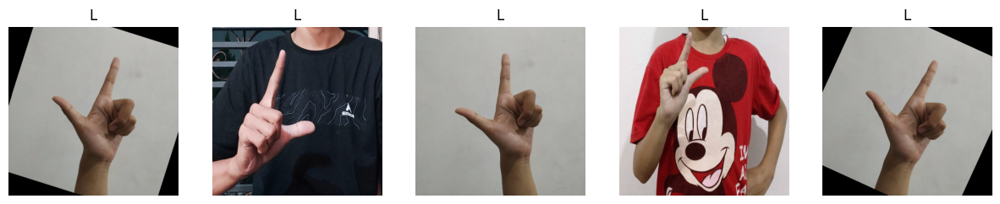

Class: C - Sample Quantity: 343
-----------------------------------------------------


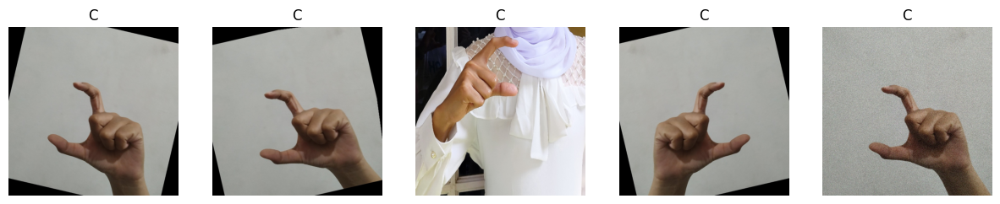

Class: Z - Sample Quantity: 360
-----------------------------------------------------


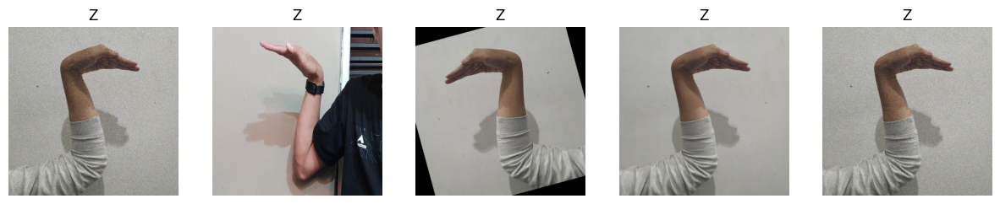

Class: A - Sample Quantity: 350
-----------------------------------------------------


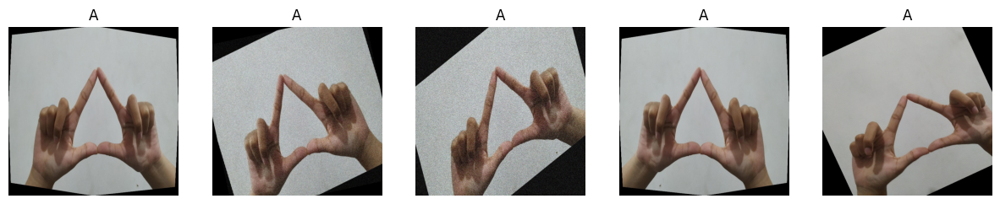

Class: G - Sample Quantity: 360
-----------------------------------------------------


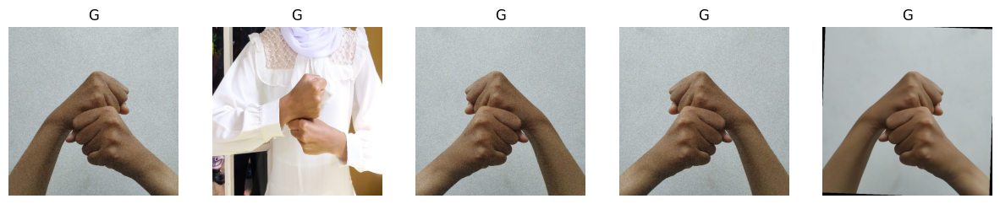

Class: N - Sample Quantity: 350
-----------------------------------------------------


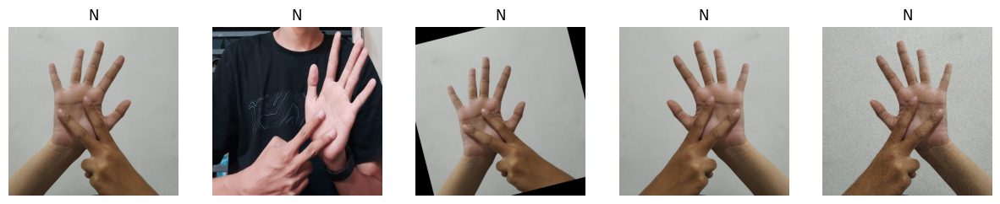

Class: V - Sample Quantity: 357
-----------------------------------------------------


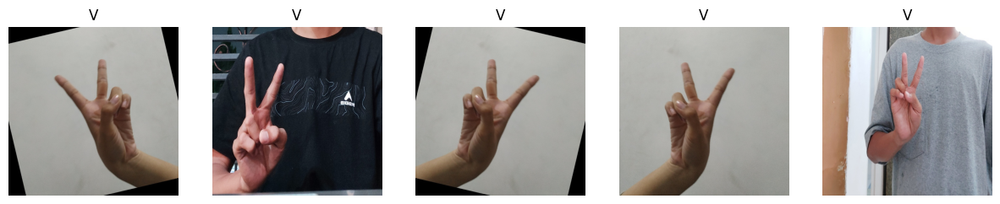

Class: M - Sample Quantity: 355
-----------------------------------------------------


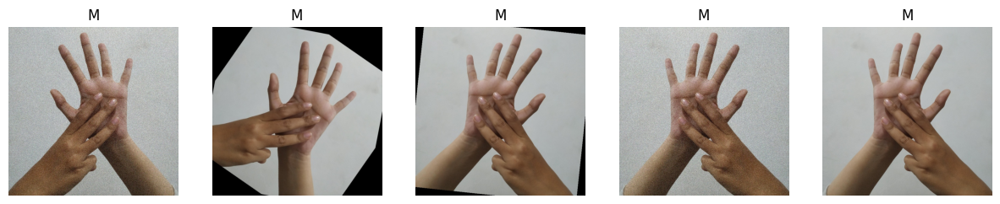

Class: U - Sample Quantity: 355
-----------------------------------------------------


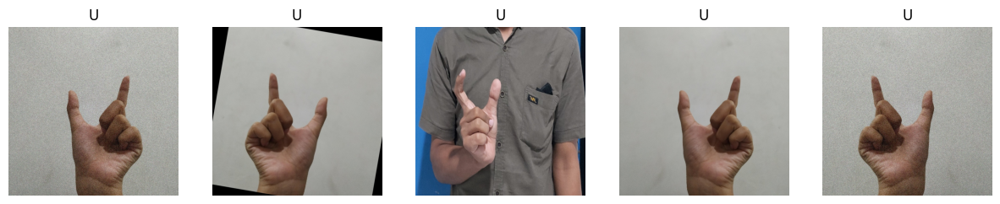

Class: X - Sample Quantity: 355
-----------------------------------------------------


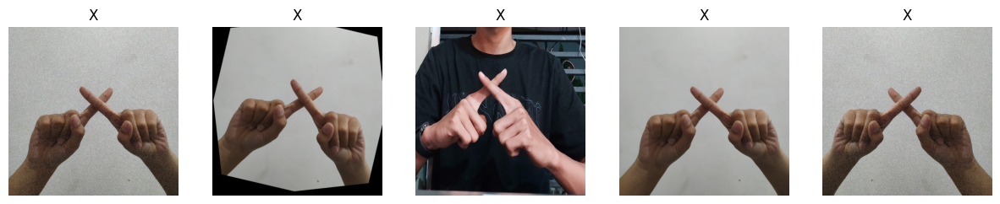

Class: S - Sample Quantity: 343
-----------------------------------------------------


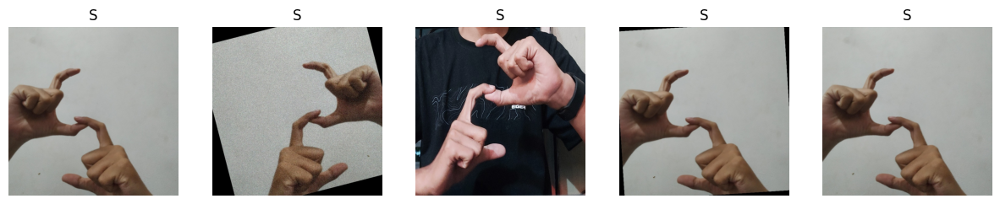

Class: F - Sample Quantity: 357
-----------------------------------------------------


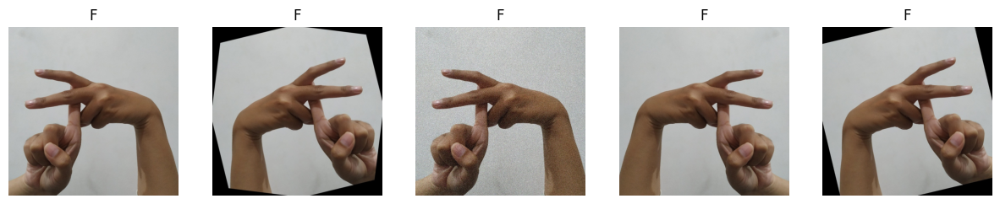

Class: B - Sample Quantity: 351
-----------------------------------------------------


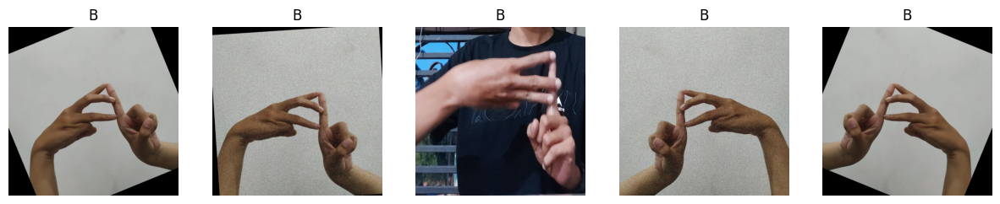


Validation Dataset:


Class: D - Sample Quantity: 87
-----------------------------------------------------


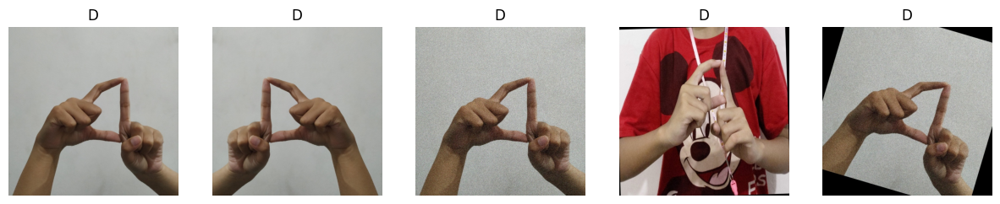

Class: W - Sample Quantity: 90
-----------------------------------------------------


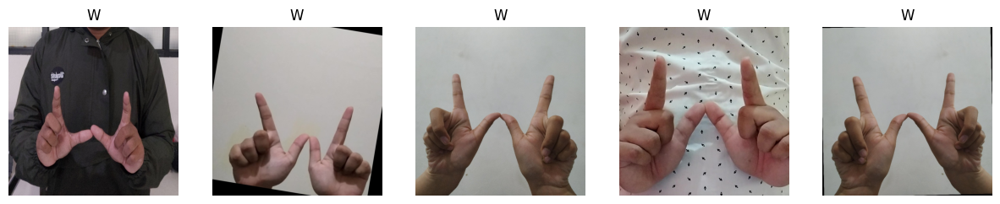

Class: R - Sample Quantity: 88
-----------------------------------------------------


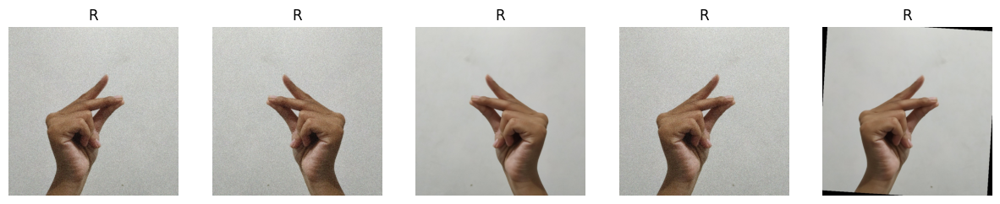

Class: K - Sample Quantity: 87
-----------------------------------------------------


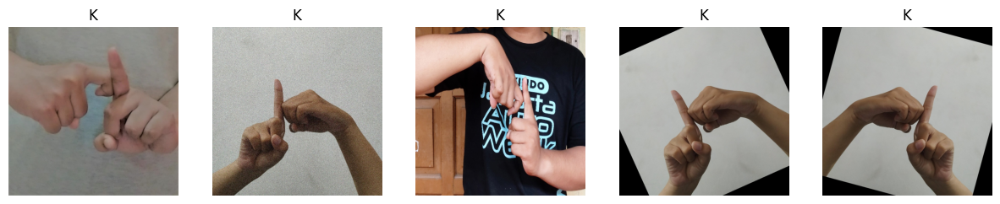

Class: J - Sample Quantity: 90
-----------------------------------------------------


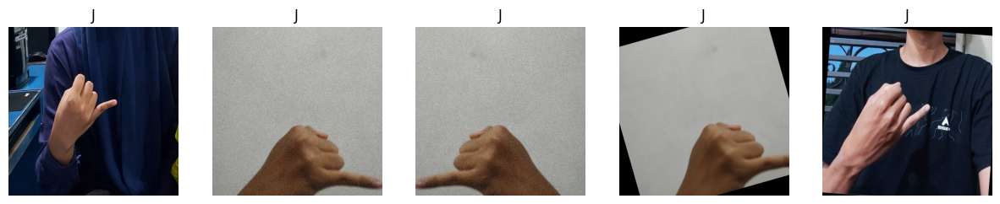

Class: E - Sample Quantity: 89
-----------------------------------------------------


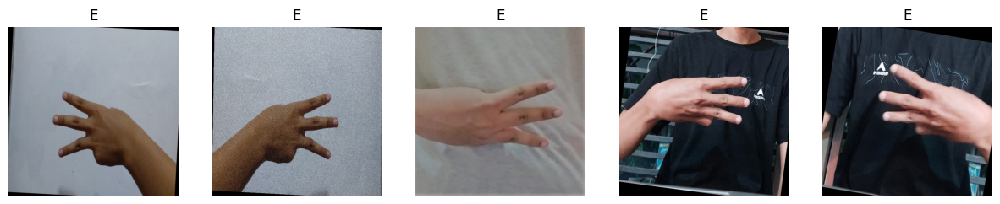

Class: O - Sample Quantity: 90
-----------------------------------------------------


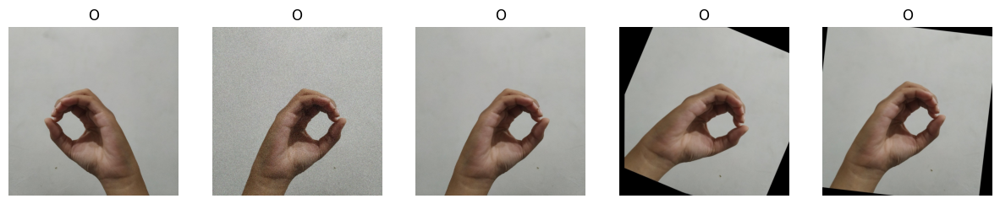

Class: I - Sample Quantity: 90
-----------------------------------------------------


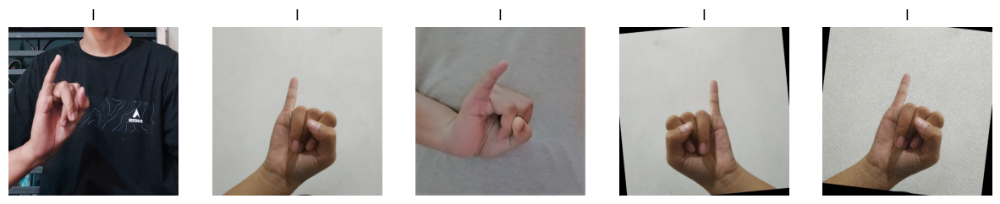

Class: Y - Sample Quantity: 83
-----------------------------------------------------


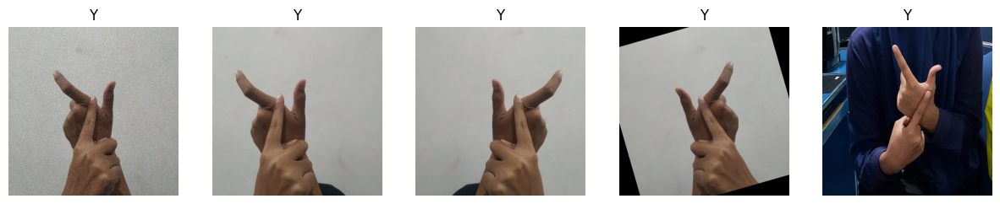

Class: H - Sample Quantity: 87
-----------------------------------------------------


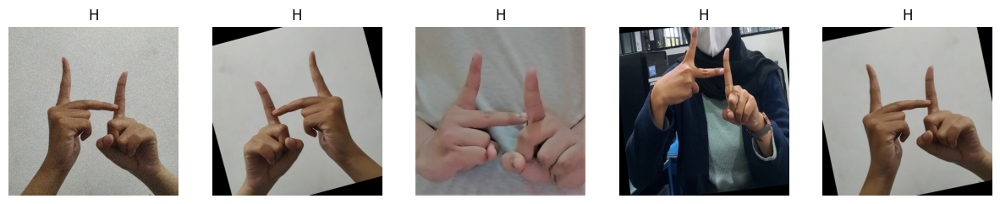

Class: P - Sample Quantity: 90
-----------------------------------------------------


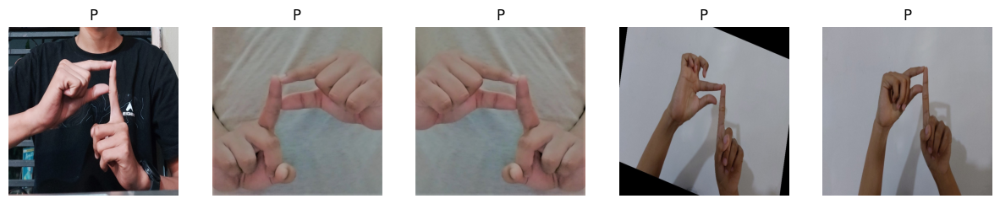

Class: Q - Sample Quantity: 87
-----------------------------------------------------


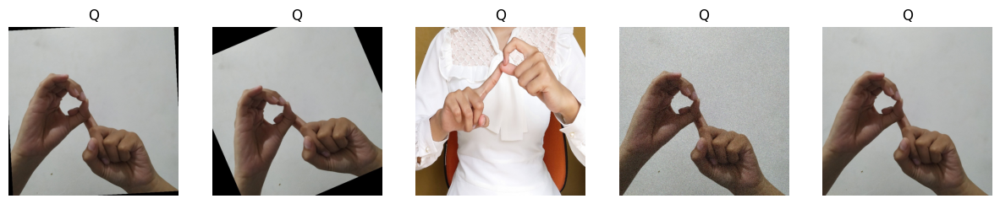

Class: T - Sample Quantity: 90
-----------------------------------------------------


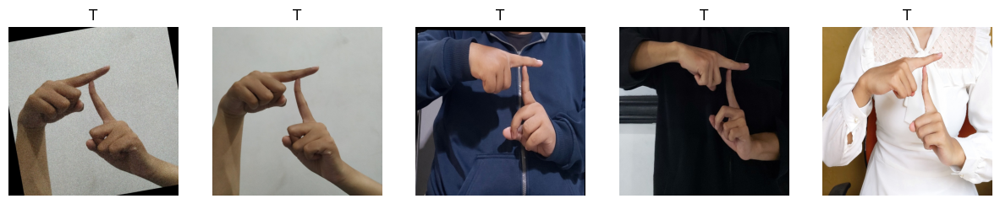

Class: L - Sample Quantity: 90
-----------------------------------------------------


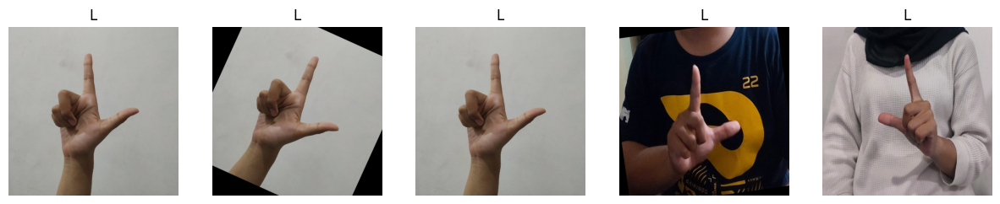

Class: C - Sample Quantity: 86
-----------------------------------------------------


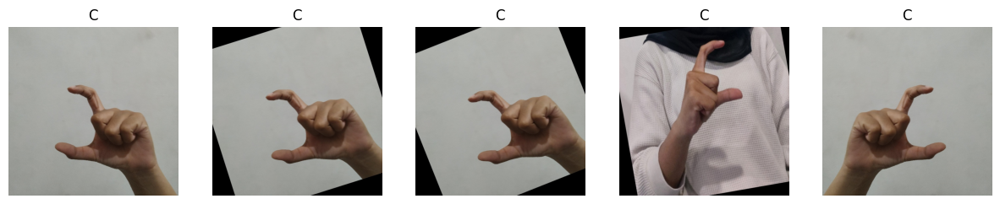

Class: Z - Sample Quantity: 90
-----------------------------------------------------


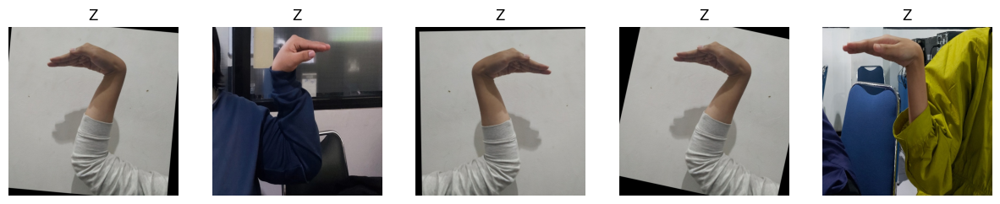

Class: A - Sample Quantity: 88
-----------------------------------------------------


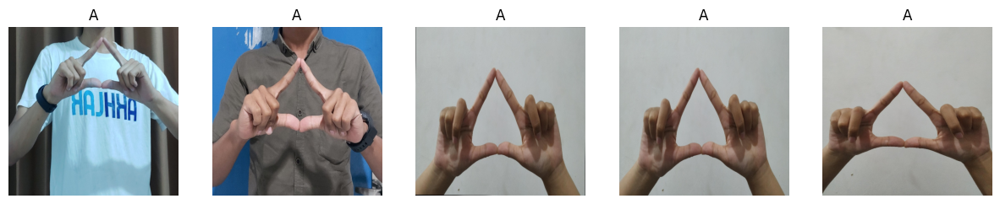

Class: G - Sample Quantity: 90
-----------------------------------------------------


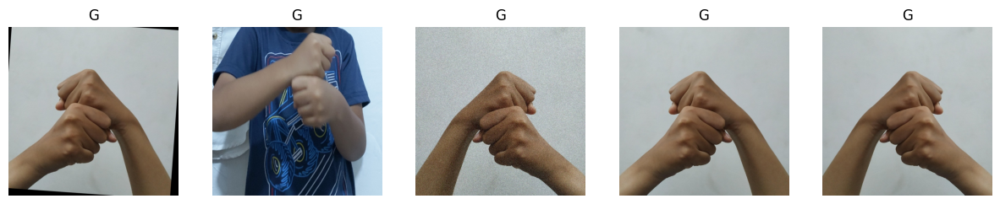

Class: N - Sample Quantity: 88
-----------------------------------------------------


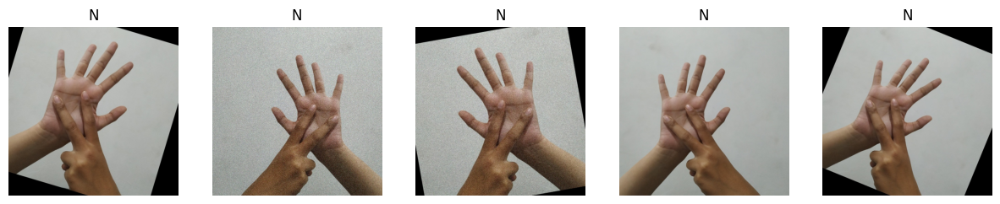

Class: V - Sample Quantity: 90
-----------------------------------------------------


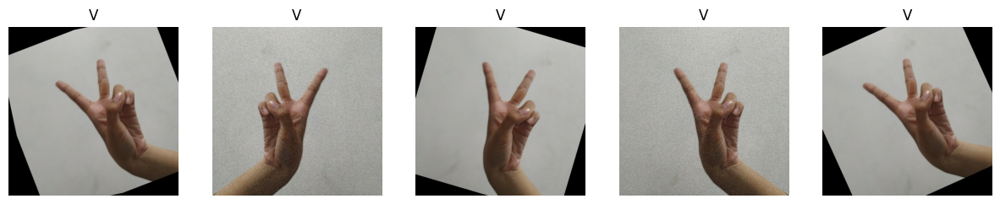

Class: M - Sample Quantity: 89
-----------------------------------------------------


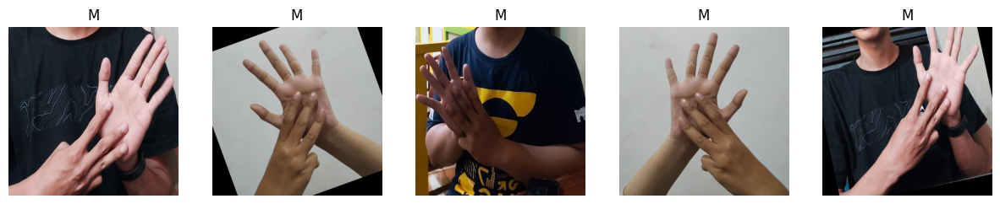

Class: U - Sample Quantity: 89
-----------------------------------------------------


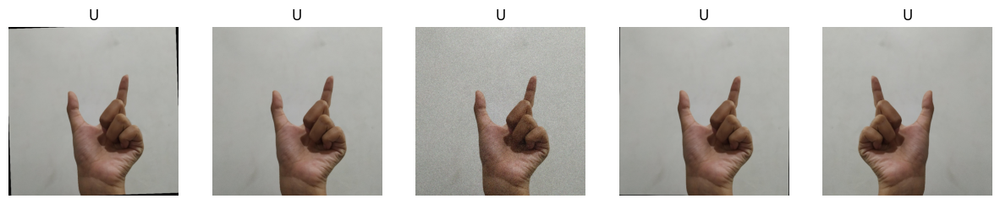

Class: X - Sample Quantity: 89
-----------------------------------------------------


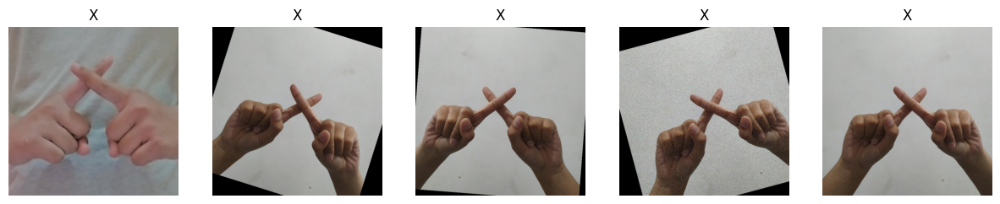

Class: S - Sample Quantity: 86
-----------------------------------------------------


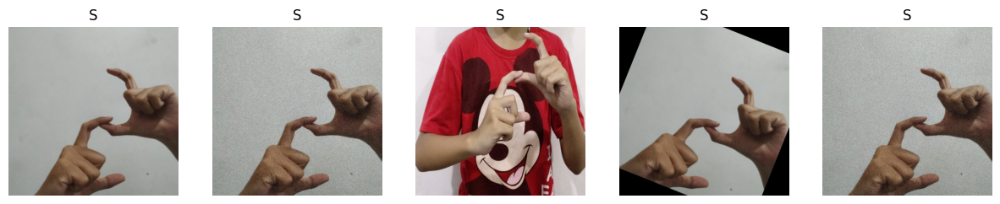

Class: F - Sample Quantity: 90
-----------------------------------------------------


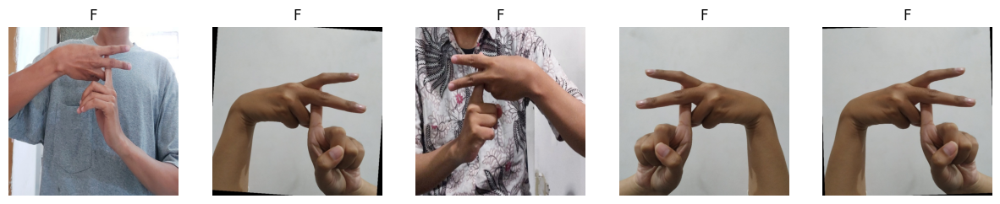

Class: B - Sample Quantity: 88
-----------------------------------------------------


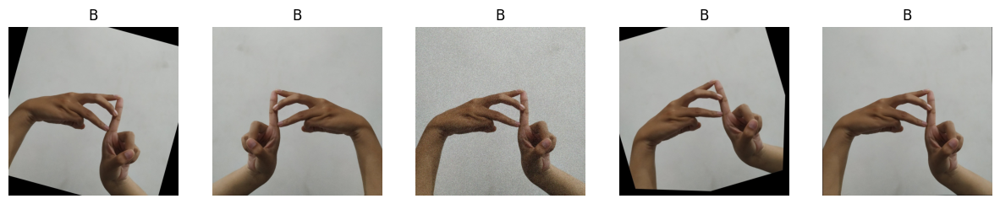

In [3]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
# for making plot

BASE_DIR = '/content/bisindo/images'

TRAIN_DIR = os.path.join(BASE_DIR, 'train')
VAL_DIR = os.path.join(BASE_DIR, 'val')


#create dictionary
train_class_counts = {}
val_class_counts = {}

def display_class_samples(path_dataset, class_counts):
    for class_name in os.listdir(path_dataset):
        class_folder = os.path.join(path_dataset, class_name)
        #Loop folder
        if os.path.isdir(class_folder):
            # count imgs in each class
            num_images = len(os.listdir(class_folder))
            class_counts[class_name] = num_images

            # plot random imgs, not sure why it's not in alphabetical order?
            print(f'Class: {class_name} - Sample Quantity: {num_images}')
            print('-----------------------------------------------------')
            plt.figure(figsize=(15, 10))
            for i, image_file in enumerate(os.listdir(class_folder)[:5]):
                image_path = os.path.join(class_folder, image_file)
                plt.subplot(1, 5, i + 1)
                image = mpimg.imread(image_path)
                plt.imshow(image)
                plt.title(class_name)
                plt.axis('off')
            plt.show()

# show imgs and its total in train dataset
if os.path.exists(TRAIN_DIR):
    print('Training Dataset:')
    print('\n')
    display_class_samples(TRAIN_DIR, train_class_counts)
else:
    print('Folder train tidak ditemukan.')

# for val dataset
if os.path.exists(VAL_DIR):
    print('\nValidation Dataset:')
    print('\n')
    display_class_samples(VAL_DIR, val_class_counts)
else:
    print('Folder val tidak ditemukan.')

In [4]:
import os
import cv2 # extract key features from each imgs
import numpy as np
from imutils import paths

#Menghitung hash gambar menggunakan metode dhash
def dhash(image, hashSize=8):
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    resized = cv2.resize(gray, (hashSize + 1, hashSize))
    diff = resized[:, 1:] > resized[:, :-1]
    return sum([2 ** i for (i, v) in enumerate(diff.flatten()) if v]) #  generate hash

#Menentukan direktori dataset dan pengaturan menghapus gambar duplikat
dataset_dir = BASE_DIR
remove_duplicates = True

#Menghitung hash masing-masing gambar
print('[INFO] computing image hashes...')
imagePaths = list(paths.list_images(dataset_dir))
hashes = {}

#Loop memproses gambar yang ada di dataset
for imagePath in imagePaths:
    image = cv2.imread(imagePath)
    img_hash = dhash(image)
    img_list = hashes.get(img_hash, [])
    img_list.append(imagePath)
    hashes[img_hash] = img_list

#Loop untuk menemukan duplikat dan menghapus gambar duplikat
# find from img hash of likely similar value
for (img_hash, duplicatePaths) in hashes.items():
    if len(duplicatePaths) > 1:
        if not remove_duplicates:
            montage = None
            for path in duplicatePaths:
                image = cv2.imread(path)
                image = cv2.resize(image, (150, 150))
                if montage is None:
                    montage = image
                else:
                    montage = np.hstack([montage, image])
            print(f"[INFO] hash: {img_hash}")
            cv2.imshow('Montage', montage)
            cv2.waitKey(0)
        else:
            for duplicate_path in duplicatePaths[1:]:
                os.remove(duplicate_path)
                print(f"[INFO] Removed duplicate: {duplicate_path}")


[INFO] computing image hashes...
[INFO] Removed duplicate: /content/bisindo/images/train/D/augmented_image_85.jpg
[INFO] Removed duplicate: /content/bisindo/images/train/D/augmented_image_53.jpg
[INFO] Removed duplicate: /content/bisindo/images/train/D/augmented_image_37.jpg
[INFO] Removed duplicate: /content/bisindo/images/train/D/augmented_image_40.jpg
[INFO] Removed duplicate: /content/bisindo/images/train/D/augmented_image_78.jpg
[INFO] Removed duplicate: /content/bisindo/images/train/D/augmented_image_42.jpg
[INFO] Removed duplicate: /content/bisindo/images/train/D/augmented_image_60.jpg
[INFO] Removed duplicate: /content/bisindo/images/train/D/augmented_image_19.jpg
[INFO] Removed duplicate: /content/bisindo/images/train/D/augmented_image_63.jpg
[INFO] Removed duplicate: /content/bisindo/images/train/D/augmented_image_30.jpg
[INFO] Removed duplicate: /content/bisindo/images/train/D/augmented_image_46.jpg
[INFO] Removed duplicate: /content/bisindo/images/train/D/augmented_image_29

In [5]:
duplicate_count = 0

for (img_hash, duplicatePaths) in hashes.items():
    if len(duplicatePaths) > 1:
        duplicate_count += len(duplicatePaths) - 1

# Menampilkan jumlah total gambar duplikat yang telah dihapus
print(f"Total gambar duplikat yang dihapus: {duplicate_count}")

Total gambar duplikat yang dihapus: 1581


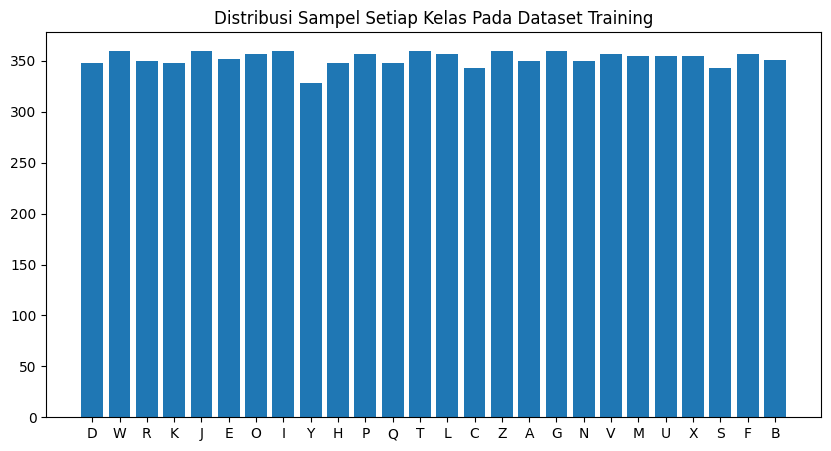

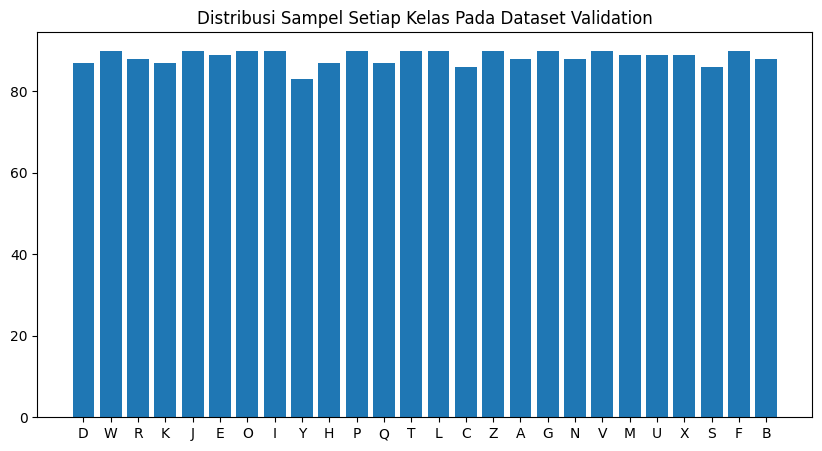

In [6]:
# Tampilkan distribusi sampel setiap kelas untuk dataset training
plt.figure(figsize=(10, 5))
plt.bar(train_class_counts.keys(), train_class_counts.values())
plt.title('Distribusi Sampel Setiap Kelas Pada Dataset Training')
plt.xticks(rotation=0)
plt.show()

# Tampilkan distribusi sampel setiap kelas untuk dataset validation
plt.figure(figsize=(10, 5))
plt.bar(val_class_counts.keys(), val_class_counts.values())
plt.title('Distribusi Sampel Setiap Kelas Pada Dataset Validation')
plt.xticks(rotation=0)
plt.show()

#Data Normalization

In [7]:
import tensorflow as tf

IMAGE_SIZE = (224, 224)
IMAGE_SHAPE = IMAGE_SIZE + (3,)

TRAINING_DIR = TRAIN_DIR
VAL_DIR = VAL_DIR

BATCH_SIZE = 32

train_dataset = tf.keras.utils.image_dataset_from_directory(
    TRAINING_DIR,
    image_size=IMAGE_SIZE,
    batch_size=BATCH_SIZE,
    label_mode='categorical',
)

val_dataset = tf.keras.utils.image_dataset_from_directory(
    VAL_DIR,
    image_size=IMAGE_SIZE,
    batch_size=BATCH_SIZE,
    label_mode='categorical',
)

Found 7953 files belonging to 26 classes.
Found 1936 files belonging to 26 classes.


In [8]:
SHUFFLE_BUFFER_SIZE = 100
PREFETCH_BUFFER_SIZE = tf.data.AUTOTUNE

train_dataset_prepared = (train_dataset
                       .shuffle(SHUFFLE_BUFFER_SIZE)
                       .cache()
                       .prefetch(PREFETCH_BUFFER_SIZE)
                       )

val_dataset_prepared = (val_dataset
                      .shuffle(SHUFFLE_BUFFER_SIZE)
                      .cache()
                      .prefetch(PREFETCH_BUFFER_SIZE)
                    )

#Modeling using MobilenetV2 Transfer Learning


In [9]:
# add callbacks

# class EarlyStoppingCallback(tf.keras.callbacks.Callback):

#     def on_epoch_end(self, epoch, logs=None):
#         # Check the original conditions (train accuracy >= 95% and val accuracy >= 90%)
#         if logs['accuracy'] >= 0.95 and logs['val_accuracy'] >= 0.9:
#             self.model.stop_training = True
#             print("\nReached 95% training accuracy and 90% validation accuracy, cancelling training!")
#             return

In [10]:
# use mobilenetV2 as base model for transfer learning
preprocess_input = tf.keras.applications.mobilenet_v2.preprocess_input

In [12]:
# Create the base model from the pre-trained model MobileNet V2
base_model = tf.keras.applications.MobileNetV2(input_shape= IMAGE_SHAPE,
                                               include_top= False, # exclude classification layers, for feature extraction
                                               weights= 'imagenet')

9406464/9406464 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


In [13]:
# freeze the base model by making it non-trainable
base_model.trainable = False

In [14]:
base_model.summary()

Model: "mobilenetv2_1.00_224"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)  │ (None, 224, 224, 3)    │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ Conv1 (Conv2D)            │ (None, 112, 112, 32)   │            864 │ input_layer[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bn_Conv1                  │ (None, 112, 112, 32)   │            128 │ Conv1[0][0]            │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ Conv1_relu (ReLU)         │ (None, 112, 112, 32)   │              0 │ bn_Conv1[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ expanded_conv_depthwise   │ (None, 112, 112, 32)   │            288 │ Conv1_relu[0][0]       │
│ (DepthwiseConv2D)         │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ expanded_conv_depthwise_… │ (None, 112, 112, 32)   │            128 │ expanded_conv_depthwi… │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ expanded_conv_depthwise_… │ (None, 112, 112, 32)   │              0 │ expanded_conv_depthwi… │
│ (ReLU)                    │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ expanded_conv_project     │ (None, 112, 112, 16)   │            512 │ expanded_conv_depthwi… │
│ (Conv2D)                  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ expanded_conv_project_BN  │ (None, 112, 112, 16)   │             64 │ expanded_conv_project… │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block_1_expand (Conv2D)   │ (None, 112, 112, 96)   │          1,536 │ expanded_conv_project… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block_1_expand_BN         │ (None, 112, 112, 96)   │            384 │ block_1_expand[0][0]   │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block_1_expand_relu       │ (None, 112, 112, 96)   │              0 │ block_1_expand_BN[0][… │
│ (ReLU)                    │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block_1_pad               │ (None, 113, 113, 96)   │              0 │ block_1_expand_relu[0… │
│ (ZeroPadding2D)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block_1_depthwise         │ (None, 56, 56, 96)     │            864 │ block_1_pad[0][0]      │
│ (DepthwiseConv2D)         │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block_1_depthwise_BN 

 Total params: 2,257,984 (8.61 MB)

 Trainable params: 0 (0.00 B)

 Non-trainable params: 2,257,984 (8.61 MB)

In [15]:
# Hyperparameter for learning rate, might not need it

# Define a learning rate schedule using tf.keras.optimizers.schedules
initial_lr = 0.001
lr_schedule = tf.keras.optimizers.schedules.ExponentialDecay(
    initial_learning_rate= initial_lr,
    decay_steps= 10000,  # How often to apply the decreasing lr (every 10.000 steps)
    decay_rate= 0.5,  # how much reduced - reduce by half
    staircase= True # keep changing every decay_steps, instead of every step
)

In [16]:
# create model

# turn preprocess into keras
class PreprocessingLayer(tf.keras.layers.Layer):
    def __init__(self, **kwargs):
        super(PreprocessingLayer, self).__init__(**kwargs)
        self.preprocess_input = tf.keras.applications.mobilenet_v2.preprocess_input

    def call(self, inputs):
        return self.preprocess_input(inputs)

inputs = tf.keras.Input(shape=IMAGE_SHAPE)
x = PreprocessingLayer()(inputs)  # part of keras layer
x = base_model(x, training=False)
x = tf.keras.layers.GlobalAveragePooling2D()(x)
x = tf.keras.layers.Dropout(0.2)(x)
outputs = tf.keras.layers.Dense(26, activation='softmax')(x)
model = tf.keras.Model(inputs, outputs)

model = tf.keras.Model(inputs, outputs)

In [17]:
model.summary()

Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_1 (InputLayer)           │ (None, 224, 224, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ preprocessing_layer                  │ (None, 224, 224, 3)         │               0 │
│ (PreprocessingLayer)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ mobilenetv2_1.00_224 (Functional)    │ (None, 7, 7, 1280)          │       2,257,984 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ global_average_pooling2d             │ (None, 1280)                │               0 │
│ (GlobalAveragePooling2D)             │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 1280)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 26)                  │          33,306 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 2,291,290 (8.74 MB)

 Trainable params: 33,306 (130.10 KB)

 Non-trainable params: 2,257,984 (8.61 MB)

In [18]:
model.compile(
    loss='categorical_crossentropy',
    optimizer=tf.keras.optimizers.Adam(learning_rate=lr_schedule),
    metrics=['accuracy']
)

In [19]:
history = model.fit(
      train_dataset_prepared,
      epochs=25,
      validation_data=val_dataset_prepared,
      # callbacks=[EarlyStoppingCallback()]
)

Epoch 1/25
249/249 ━━━━━━━━━━━━━━━━━━━━ 72s 201ms/step - accuracy: 0.4502 - loss: 2.1593 - val_accuracy: 0.8228 - val_loss: 0.7299
Epoch 2/25
249/249 ━━━━━━━━━━━━━━━━━━━━ 23s 35ms/step - accuracy: 0.8245 - loss: 0.6708 - val_accuracy: 0.8724 - val_loss: 0.5041
Epoch 3/25
249/249 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - accuracy: 0.8857 - loss: 0.4413 - val_accuracy: 0.9008 - val_loss: 0.3935
Epoch 4/25
249/249 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - accuracy: 0.9171 - loss: 0.3356 - val_accuracy: 0.9220 - val_loss: 0.3284
Epoch 5/25
249/249 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - accuracy: 0.9337 - loss: 0.2633 - val_accuracy: 0.9282 - val_loss: 0.2939
Epoch 6/25
249/249 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - accuracy: 0.9522 - loss: 0.2166 - val_accuracy: 0.9267 - val_loss: 0.2713
Epoch 7/25
249/249 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - accuracy: 0.9600 - loss: 0.1826 - val_accuracy: 0.9360 - val_loss: 0.2457
Epoch 8/25
249/249 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - accuracy: 0.9643 - loss: 0.1648 - val

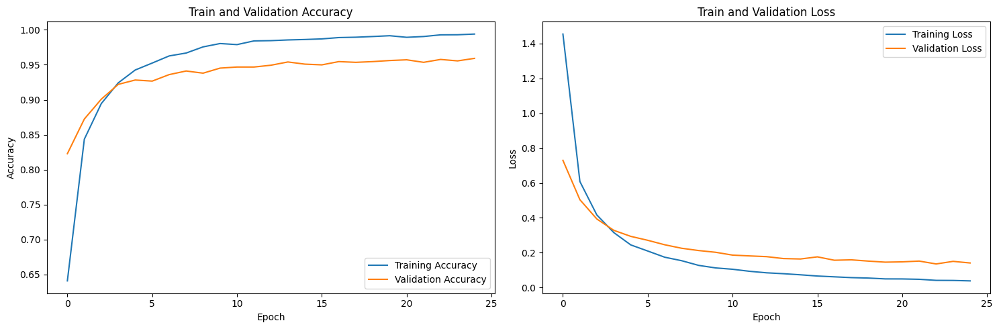

In [20]:
import matplotlib.pyplot as plt

fig, axes = plt.subplots(1, 2, figsize=(15, 5))

# Plot Accuracy
axes[0].plot(history.history['accuracy'], label='Training Accuracy')
axes[0].plot(history.history['val_accuracy'], label='Validation Accuracy')
axes[0].set_title('Train and Validation Accuracy')
axes[0].set_xlabel('Epoch')
axes[0].set_ylabel('Accuracy')
axes[0].legend()

# Plot Loss
axes[1].plot(history.history['loss'], label='Training Loss')
axes[1].plot(history.history['val_loss'], label='Validation Loss')
axes[1].set_title('Train and Validation Loss')
axes[1].set_xlabel('Epoch')
axes[1].set_ylabel('Loss')
axes[1].legend()

plt.tight_layout()
plt.show()

In [21]:
from keras.models import load_model
model.save('my_model.h5')

In [22]:
# from tensorflow.keras.models import load_model
# loaded_model = load_model("my_model.h5", custom_objects={"PreprocessingLayer": PreprocessingLayer})

# Handling Test

In [23]:
import kagglehub

# Download latest version
test_path = kagglehub.dataset_download("idhamozi/indonesian-sign-language-bisindo")

print("Path to dataset test files:", test_path)

100%|██████████| 890M/890M [00:09<00:00, 94.8MB/s]

Extracting files...


Path to dataset test files: /root/.cache/kagglehub/datasets/idhamozi/indonesian-sign-language-bisindo/versions/1


In [24]:
for item in os.listdir(test_path):
    source = os.path.join(test_path, item)
    shutil.move(source, destination_path)

print("Dataset moved to:", destination_path)

Dataset moved to: /content


In [78]:
TEST_DIR = '/content/Dataset BISINDO/datatrain'

In [81]:
from PIL import Image, ImageOps # for handle images

# fix images upside down for some reason
def fix_image_orientation(image_path):
    img = Image.open(image_path)
    img = ImageOps.exif_transpose(img)  # This will automatically fix orientation based on EXIF data
    img.save(image_path)  # Save the fixed image back

# Loop through all class folders in the TEST_DIR
for class_folder in os.listdir(TEST_DIR):
    class_folder_path = os.path.join(TEST_DIR, class_folder)

    # Check if it's a directory (in case there are other files in TEST_DIR)
    if os.path.isdir(class_folder_path):
        # Loop through all images in the class folder
        for image_name in os.listdir(class_folder_path):
            image_path = os.path.join(class_folder_path, image_name)

            # Check if it's a file (in case there are directories or non-image files)
            if os.path.isfile(image_path):
                fix_image_orientation(image_path)


Training Dataset:


Class: D - Sample Quantity: 63
-----------------------------------------------------


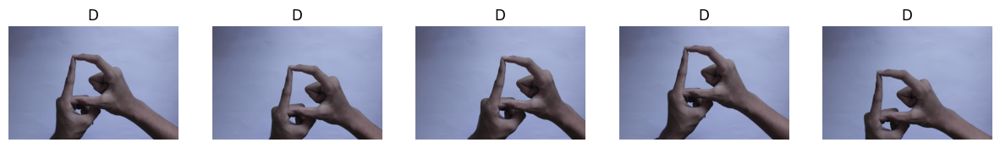

Class: W - Sample Quantity: 64
-----------------------------------------------------


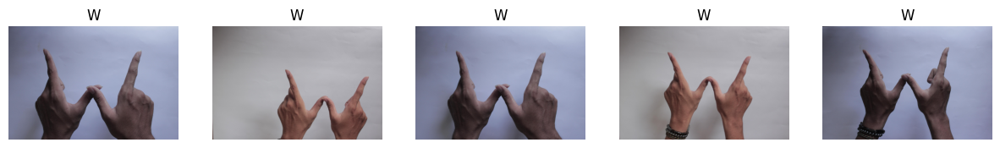

Class: R - Sample Quantity: 59
-----------------------------------------------------


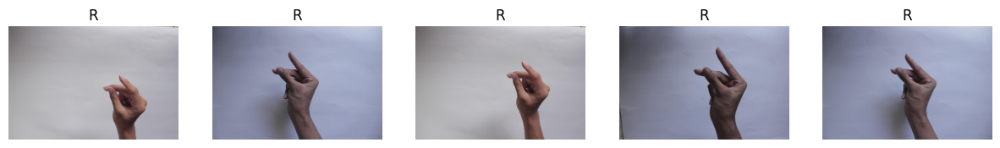

Class: K - Sample Quantity: 63
-----------------------------------------------------


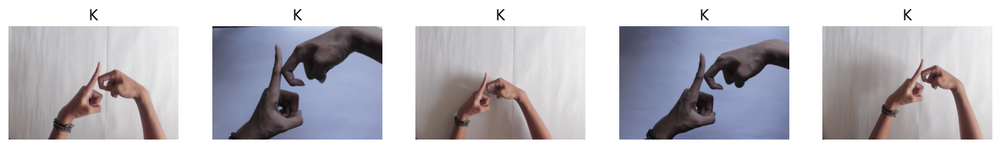

Class: J - Sample Quantity: 63
-----------------------------------------------------


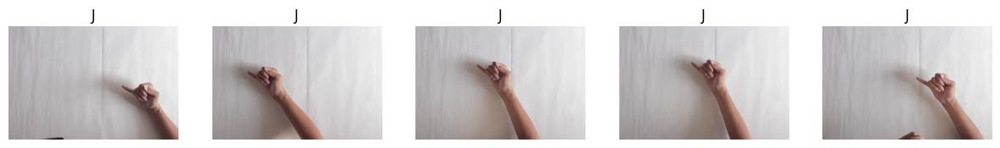

Class: E - Sample Quantity: 64
-----------------------------------------------------


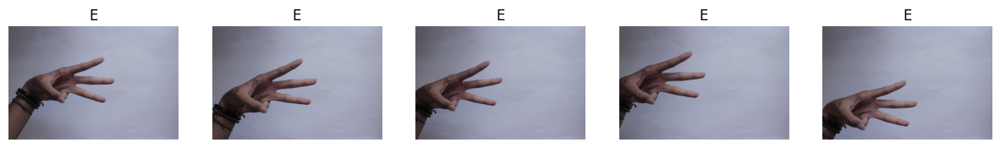

Class: O - Sample Quantity: 64
-----------------------------------------------------


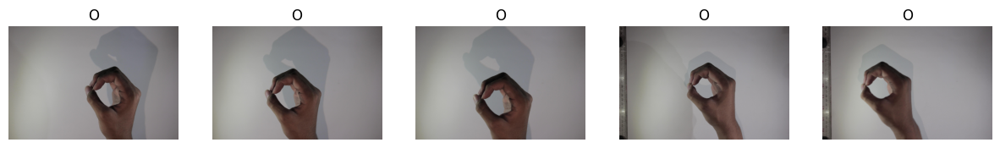

Class: I - Sample Quantity: 64
-----------------------------------------------------


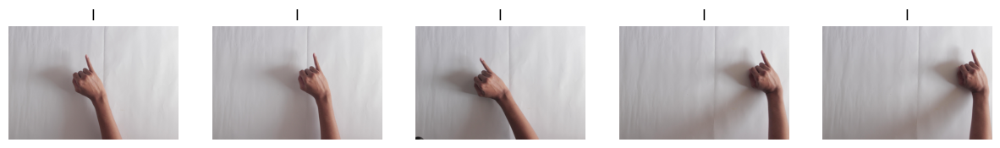

Class: Y - Sample Quantity: 60
-----------------------------------------------------


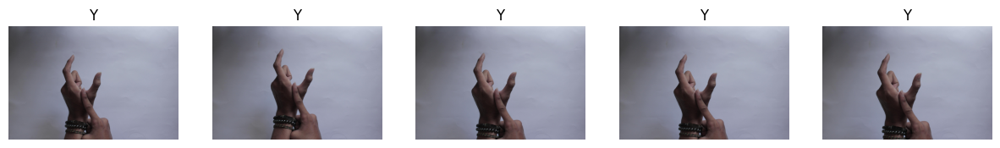

Class: H - Sample Quantity: 61
-----------------------------------------------------


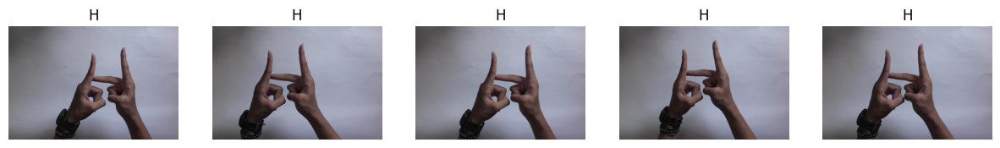

Class: P - Sample Quantity: 59
-----------------------------------------------------


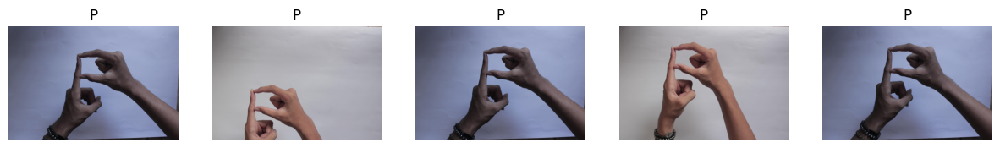

Class: Q - Sample Quantity: 63
-----------------------------------------------------


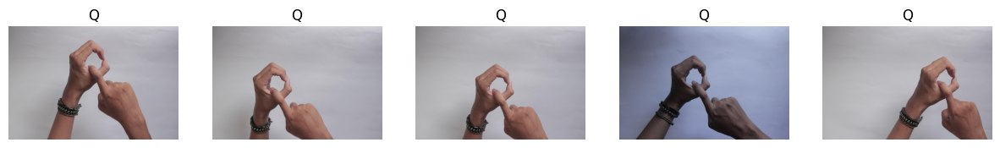

Class: T - Sample Quantity: 64
-----------------------------------------------------


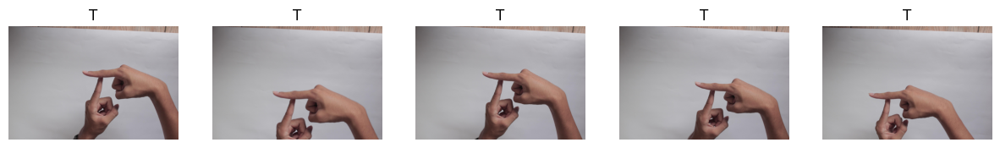

Class: L - Sample Quantity: 63
-----------------------------------------------------


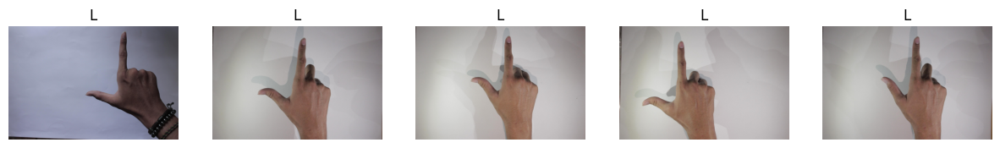

Class: C - Sample Quantity: 64
-----------------------------------------------------


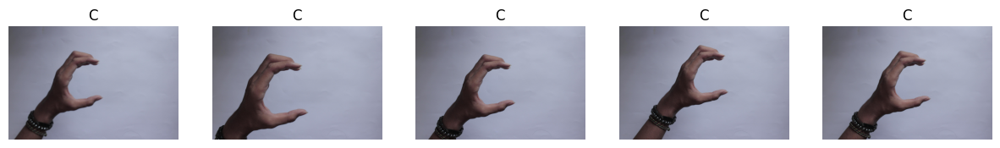

Class: Z - Sample Quantity: 64
-----------------------------------------------------


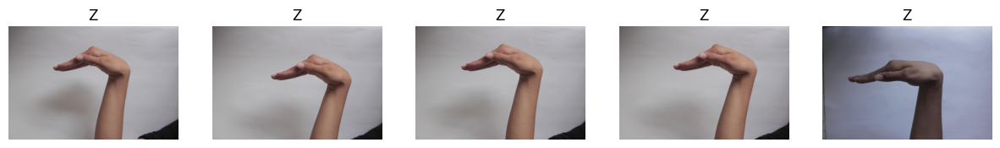

Class: A - Sample Quantity: 64
-----------------------------------------------------


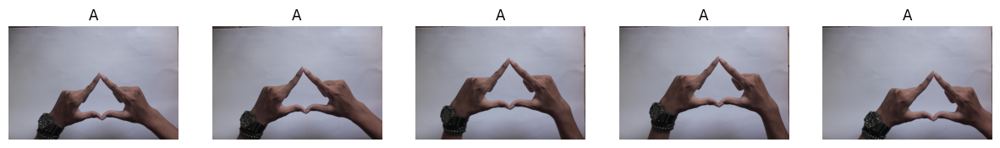

Class: G - Sample Quantity: 64
-----------------------------------------------------


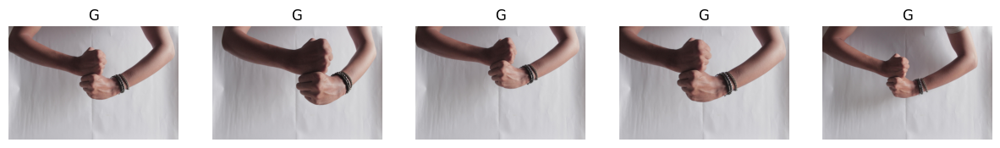

Class: N - Sample Quantity: 64
-----------------------------------------------------


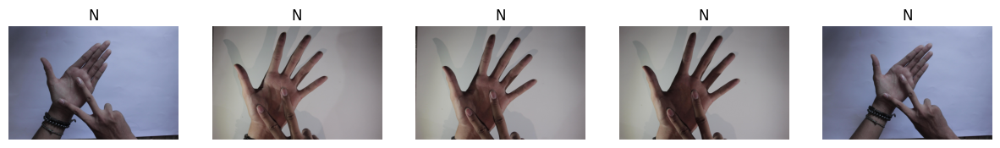

Class: V - Sample Quantity: 64
-----------------------------------------------------


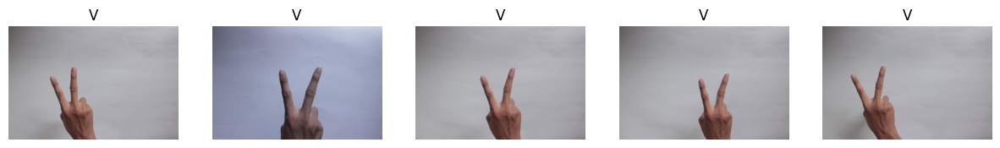

Class: M - Sample Quantity: 63
-----------------------------------------------------


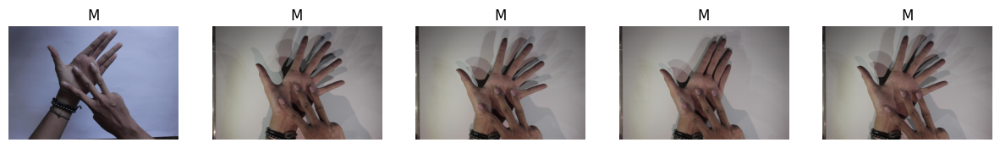

Class: U - Sample Quantity: 61
-----------------------------------------------------


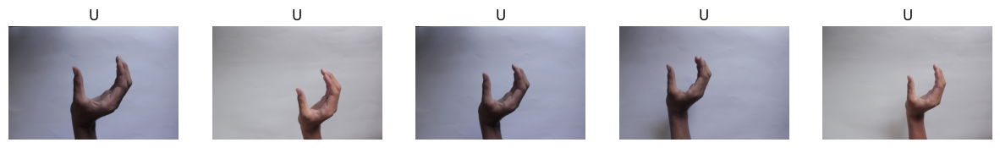

Class: X - Sample Quantity: 64
-----------------------------------------------------


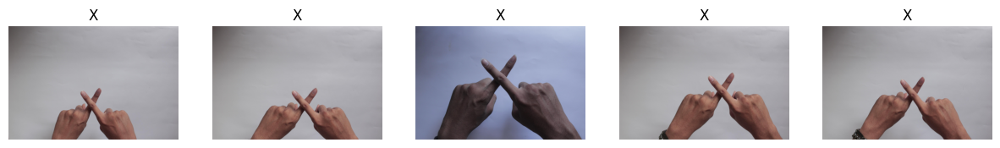

Class: S - Sample Quantity: 60
-----------------------------------------------------


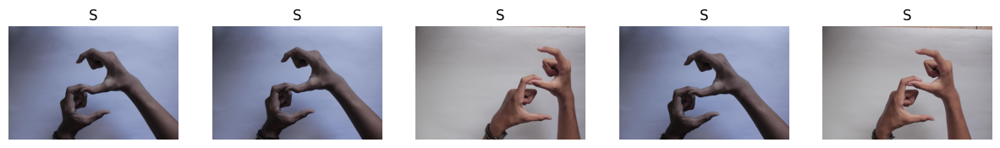

Class: F - Sample Quantity: 63
-----------------------------------------------------


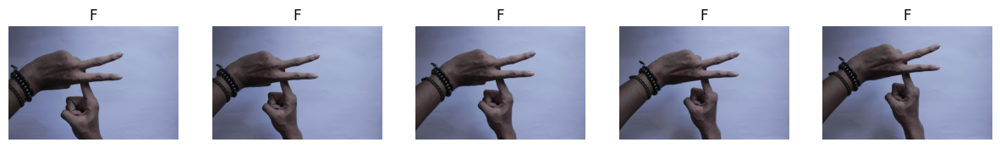

Class: B - Sample Quantity: 64
-----------------------------------------------------


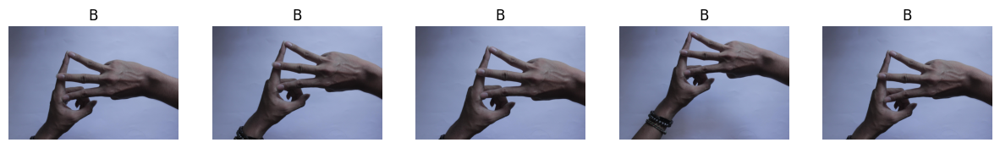

In [82]:
#create dictionary
test_class_counts = {}

def display_class_samples(path_dataset, class_counts):
    for class_name in os.listdir(path_dataset):
        class_folder = os.path.join(path_dataset, class_name)
        #Loop folder
        if os.path.isdir(class_folder):
            # count imgs in each class
            num_images = len(os.listdir(class_folder))
            class_counts[class_name] = num_images

            # plot random imgs, not sure why it's not in alphabetical order?
            print(f'Class: {class_name} - Sample Quantity: {num_images}')
            print('-----------------------------------------------------')
            plt.figure(figsize=(15, 10))
            for i, image_file in enumerate(os.listdir(class_folder)[:5]):
                image_path = os.path.join(class_folder, image_file)
                plt.subplot(1, 5, i + 1)
                image = mpimg.imread(image_path)
                plt.imshow(image)
                plt.title(class_name)
                plt.axis('off')
            plt.show()

# show imgs and its total in train dataset
if os.path.exists(TEST_DIR):
    print('Training Dataset:')
    print('\n')
    display_class_samples(TEST_DIR, test_class_counts)
else:
    print('Folder train tidak ditemukan.')


In [48]:
#Menghitung hash gambar menggunakan metode dhash
def dhash(image, hashSize=8):
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    resized = cv2.resize(gray, (hashSize + 1, hashSize))
    diff = resized[:, 1:] > resized[:, :-1]
    return sum([2 ** i for (i, v) in enumerate(diff.flatten()) if v]) #  generate hash

#Menentukan direktori dataset dan pengaturan menghapus gambar duplikat
dataset_dir = TEST_DIR
remove_duplicates = True

#Menghitung hash masing-masing gambar
print('[INFO] computing image hashes...')
imagePaths = list(paths.list_images(dataset_dir))
hashes = {}

#Loop memproses gambar yang ada di dataset
for imagePath in imagePaths:
    image = cv2.imread(imagePath)
    img_hash = dhash(image)
    img_list = hashes.get(img_hash, [])
    img_list.append(imagePath)
    hashes[img_hash] = img_list

#Loop untuk menemukan duplikat dan menghapus gambar duplikat
# find from img hash of likely similar value
for (img_hash, duplicatePaths) in hashes.items():
    if len(duplicatePaths) > 1:
        if not remove_duplicates:
            montage = None
            for path in duplicatePaths:
                image = cv2.imread(path)
                image = cv2.resize(image, (150, 150))
                if montage is None:
                    montage = image
                else:
                    montage = np.hstack([montage, image])
            print(f"[INFO] hash: {img_hash}")
            cv2.imshow('Montage', montage)
            cv2.waitKey(0)
        else:
            for duplicate_path in duplicatePaths[1:]:
                os.remove(duplicate_path)
                print(f"[INFO] Removed duplicate: {duplicate_path}")


[INFO] computing image hashes...
[INFO] Removed duplicate: /content/Dataset BISINDO/datatrain/D/IMG_1473.JPG
[INFO] Removed duplicate: /content/Dataset BISINDO/datatrain/R/IMG_0338.JPG
[INFO] Removed duplicate: /content/Dataset BISINDO/datatrain/R/IMG_1822.JPG
[INFO] Removed duplicate: /content/Dataset BISINDO/datatrain/R/IMG_1832.JPG
[INFO] Removed duplicate: /content/Dataset BISINDO/datatrain/R/IMG_1825.JPG
[INFO] Removed duplicate: /content/Dataset BISINDO/datatrain/R/IMG_1831.JPG
[INFO] Removed duplicate: /content/Dataset BISINDO/datatrain/K/IMG_9848.JPG
[INFO] Removed duplicate: /content/Dataset BISINDO/datatrain/J/IMG_9801.JPG
[INFO] Removed duplicate: /content/Dataset BISINDO/datatrain/Y/IMG_1959.JPG
[INFO] Removed duplicate: /content/Dataset BISINDO/datatrain/Y/IMG_1947.JPG
[INFO] Removed duplicate: /content/Dataset BISINDO/datatrain/Y/IMG_1969.JPG
[INFO] Removed duplicate: /content/Dataset BISINDO/datatrain/Y/IMG_1955.JPG
[INFO] Removed duplicate: /content/Dataset BISINDO/data

In [49]:
test_dataset = tf.keras.utils.image_dataset_from_directory(
    TEST_DIR,
    image_size=IMAGE_SIZE,
    batch_size=BATCH_SIZE,
    label_mode='categorical',
)

Found 1687 files belonging to 27 classes.


In [50]:
for images, labels in train_dataset.take(1):
    print("Train labels shape:", labels.shape)
for images, labels in test_dataset.take(1):
    print("Test labels shape:", labels.shape)


Train labels shape: (32, 26)
Test labels shape: (32, 27)


In [51]:
# remove class NOTHING
!rm -rf '/content/Dataset BISINDO/datatrain/NOTHING'

In [52]:
!ls '/content/Dataset BISINDO/datatrain'


A  B  C  D  E  F  G  H	I  J  K  L  M  N  O  P	Q  R  S  T  U  V  W  X	Y  Z


In [85]:
test_dataset = tf.keras.utils.image_dataset_from_directory(
    TEST_DIR,
    image_size=IMAGE_SIZE,
    batch_size=BATCH_SIZE,
    label_mode='categorical',
)

Found 1633 files belonging to 26 classes.


In [83]:
for images, labels in train_dataset.take(1):
    print("Train labels shape:", labels.shape)
for images, labels in test_dataset.take(1):
    print("Test labels shape:", labels.shape)

Train labels shape: (32, 26)
Test labels shape: (32, 26)


In [86]:
test_loss, test_accuracy = model.evaluate(test_dataset)
print("Test Accuracy:", test_accuracy)

52/52 ━━━━━━━━━━━━━━━━━━━━ 22s 429ms/step - accuracy: 0.4759 - loss: 2.0592
Test Accuracy: 0.4941824972629547


In [72]:
val_loss, val_accuracy = model.evaluate(val_dataset_prepared)
print("Validation Accuracy:", val_accuracy)

61/61 ━━━━━━━━━━━━━━━━━━━━ 2s 26ms/step - accuracy: 0.9641 - loss: 0.1273
Validation Accuracy: 0.9591942429542542
